In [1]:
# initial imports
import os

import panel as pn
pn.extension('plotly')
import plotly.express as px
import pandas as pd
import hvplot.pandas
import matplotlib.pyplot as plt
from pathlib import Path
from dotenv import load_dotenv

%matplotlib inline

In [2]:
# Read the Mapbox API key
load_dotenv()
mapbox_token = os.getenv("MAPBOX_API_KEY")

In [3]:
# Read the intennet plans data into a Pandas DataFrame
plan_data = pd.read_csv("us_internet_plans.csv")
#plan_data = pd.read_csv(file_path, index_col="Plan")
plan_data.head()

,Plan,City,State,Zip_code,County,ISP,Network_ tech,Municipal_network,Download_speed_Mbps,Upload_speed_Mbps,...,Self_install_ fee,Router_rental_monthly,Modem_rental_monthly,Ttl_rental_costs,router_purchase_cost,Modem_purchase_cost,Ttl_purch_costs,requirement_months,Termination_fee,Address_used
0,"Ammon, Century Link, 100",Ammon,ID,83406.0,Bonneville,CenturyLink,ADSL,No,100.0,12.000,...,NaN,5,15,20,NaN,150,150,1.0,NaN,3039 S 25 E
1,"Ammon, Century Link, 60",Ammon,ID,83406.0,Bonneville,CenturyLink,ADSL,No,60.0,30.000,...,NaN,5,15,20,NaN,150,150,1.0,NaN,3039 S 25 E
2,"Ammon, Century Link, 80",Ammon,ID,83406.0,Bonneville,CenturyLink,ADSL,No,80.0,40.000,...,NaN,5,15,20,NaN,150,150,1.0,NaN,3039 S 25 E
3,"Ammon, CenturyLink, 12",Ammon,ID,83406.0,Bonneville,CenturyLink,ADSL,No,12.0,0.896,...,50,5,15,20,NaN,150,150,1.0,NaN,1815 Sabin Dr
4,"Ammon, CenturyLink, 20",Ammon,ID,83406.0,Bonneville,CenturyLink,ADSL,No,20.0,0.896,...,50,5,15,20,NaN,150,150,1.0,NaN,1815 Sabin Dr


In [4]:
#Groupby avg (all columns) by Zip code
plangroupby=plan_data.groupby('Zip_code').mean().reset_index()
plangroupby.head()



,Zip_code,Download_speed_Mbps,Upload_speed_Mbps,Data_cap_GB,Price,Promotional_price,Autopay_/_paperless_discount,Activation_fee,router_purchase_cost,requirement_months
0,10027.0,513.333333,21.666667,NaN,94.323333,71.656667,NaN,NaN,NaN,1.00
1,10034.0,30.000000,4.000000,NaN,14.990000,14.990000,NaN,NaN,NaN,1.00
2,10110.0,100.000000,10.000000,NaN,NaN,44.990000,NaN,NaN,NaN,1.00
3,11201.0,476.250000,476.250000,NaN,NaN,37.490000,NaN,9.99,NaN,1.00
4,11205.0,450.000000,450.000000,NaN,122.490000,67.490000,10.0,NaN,NaN,18.25


In [5]:
plan_data["Zip_code"]=plan_data["Zip_code"].astype("str")

In [6]:
# plot price by Zip code
plan_data.hvplot.bar('Zip_code', 'Price', xlabel ="Zip_code", ylabel= "Price", width=250, height=400, groupby="Zip_code")


:DynamicMap   [City]
   :Bars   [City]   (Price)

In [22]:
#Groupby avg (all columns) by City
plan_city=plan_data.groupby('City').mean().reset_index()
plan_city.head()

,City,Download_speed_Mbps,Upload_speed_Mbps,Data_cap_GB,Price,Promotional_price,Autopay_/_paperless_discount,Activation_fee,router_purchase_cost,requirement_months
0,Ammon,313.347826,238.251826,827.272727,42.014500,47.142857,NaN,NaN,NaN,1.000000
1,Atlanta,787.534909,619.518182,1000.000000,121.272727,61.111111,10.0,29.166667,NaN,7.000000
2,Chattanooga,974.533333,850.833333,1000.000000,92.398000,56.666667,10.0,35.000000,NaN,9.800000
3,Cleveland,337.761905,231.136364,1000.000000,67.036667,58.071538,15.0,15.000000,0.0,11.562500
4,Fort Collins,808.846154,1210.318182,NaN,118.554545,61.402353,NaN,NaN,NaN,7.423077


In [16]:
# plot Avarage price by city
plan_city.hvplot.bar('City', 'Price', xlabel ="City", ylabel= "Price", width=2000, height=400)

:Bars   [City]   (Price)

In [24]:
# plot Avarage download speedby city
plan_city.hvplot.bar('City', 'Download_speed_Mbps', xlabel ="City", ylabel= "Download_speed_Mbps", width=2000, height=400)

:Bars   [City]   (Download_speed_Mbps)

In [26]:
# Read the intennet plans data into a Pandas DataFrame
celltower_data = pd.read_csv("cellular_towers.csv")

celltower_data.tail()

,X,Y,FID,LICENSEE,CALLSIGN,LOCNUM,LAT_DMS,LATDIR,LON_DMS,LONDIR,...,LOCCITY,LOCCOUNTY,LOCSTATE,NEPA,QZONE,TOWREG,SUPSTRUC,ALLSTRUC,STRUCTYPE,LIC_ID
23493,-12687851.88,5503358.379,23494,"CUSTER TELEPHONE COOPERATIVE, INC.",WQOA586,2,"44,14,40",N,"113,58,37",W,...,DICKEY,CUSTER,ID,NaN,NaN,NaN,11.0,13.4,TOWER,3306717
23494,-12654055.27,5454184.079,23495,"CUSTER TELEPHONE COOPERATIVE, INC.",WQOA586,3,"43,55,38",N,"113,40,24",W,...,MACKAY,CUSTER,ID,NaN,NaN,1278857.0,15.2,15.2,TOWER,3306717
23495,-12794629.56,5498992.833,23496,"CUSTER TELEPHONE COOPERATIVE, INC.",WQOA586,4,"44,12,59",N,"114,56,10",W,...,STANLEY,CUSTER,ID,NaN,NaN,NaN,6.1,7.3,POLE,3306717
23496,-11821296.14,4347120.131,23497,"TISDALE TELEPHONE COMPANY, LLC",WQOI295,1,"36,20,14",N,"106,11,33",W,...,EL RITO,RIO ARRIBA,NM,NaN,NaN,NaN,21.0,21.0,POLE,3322196
23497,-12080581.77,6248467.834,23498,"TRIANGLE COMMUNICATION SYSTEM, INC.",WQOQ507,1,"48,50,39",N,"108,31,18",W,...,TURNER,BLAINE,MT,NaN,NaN,1281437.0,91.4,93.0,TOWER,3339826


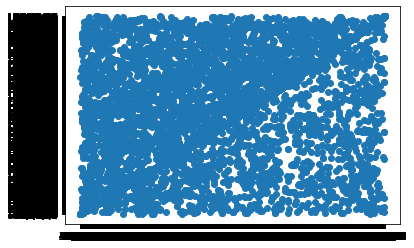

In [28]:
#WARNING plotting the cell towers takes forever
#x = celltower_data.LAT_DMS
#y = celltower_data.LON_DMS
plt.scatter(x,y)

In [9]:
# clean data
#census_files = "../data"
#for file in census_files.glob('*.csv'):
 #   df = pd.read_csv(file)
  #  df.filena(0, inplace=True)
   # fig, ax = plt.subplots()
   #stategroup=df.groupby('Geography')

#df
